 ===================================================     
    This code is created by:
    
    Dr. Vikram Singh Dharodi,
    Institute for Plasma research,India,
    Email: dharodiv@msu.edu,
    Web: https://sites.google.com/site/vsdharodi

    Prof. Michael S. Murillo
    Michigan State University, USA,
    Email: murillom@msu.edu,
    Web: https://cmse.msu.edu/directory/faculty/michael-s-murillo/
 ===================================================    

## Langevin dynamics of a particle in double-well potential:

### Step 1. Define the potential well

### Step 2. Define the initial conditions

### Step 3. Move the particle in well by using the Langevin's equation of motion 
 ${m}{\dot{{v}}}={f(r)-}{\overbrace{
{\hspace{-0.85cm}}{\underbrace{{\zeta}}_\text
{Friction coefficient}}{\hspace{-0.85cm}}{m}{\dot{r}}}^\text
{Dissipative frictional force}}+{\underbrace{\alpha}_\text
{Amplitude}}{\hspace{-0.0cm}}{\overbrace{{{\hspace{0.0cm}}}{{R}}(t)}^{{\hspace{0.0cm}}\text{Noise}}}{\hspace{-0.01cm}}$

In [11]:
# importing the required modules 
import time
import matplotlib.pyplot as plt 
import numpy as np 
import math 
print ('Updated on', time.strftime("%d/%m/%Y"))

Updated on 01/08/2021


In [12]:
# setting the x-coordinates 
rmin=-10
rmax=10
ngr=1200
rdis = np.linspace(rmin,rmax,ngr)
#print(xx)

In [13]:
# Parameters of double-well potential:
cntr=0;
a4 =1/(2.50e+12)
a2 =1/(3.50e+10) 
sigma=2.0e-10
coff=math.sqrt(a4/(2*a2))
coffw=sigma*coff
UEnergy =a4*(rdis-cntr)**4-a2*(rdis-cntr)**2+coffw*(rdis-cntr)

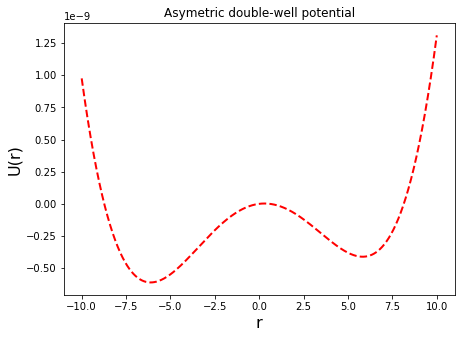

In [14]:
fig_well = plt.figure(figsize=(7,5))
plt.plot(rdis,UEnergy, linestyle='--', color='r',linewidth=2)
plt.title('Asymetric double-well potential', fontsize=12)
# plt.yticks(np.arange(-1e-9, 1.5e-9, 0.5e-9), fontsize=12)
# plt.xticks(np.arange(-12, 12, 2.5), fontsize=12) 
plt.xlabel('r', fontsize=16)  
plt.ylabel('U(r)', fontsize=16)  
plt.draw()
# fig.savefig('fig_well.png', dpi=300)

In [15]:
Ubmp = UEnergy[(rdis>=-1) & (rdis<=1)]
Ubump=max(Ubmp)
UminR=min(UEnergy[(rdis>=4) & (rdis<=10)])
rint = rdis[np.where(UEnergy == UminR)]
IntPE =a4*(rint-cntr)**4-a2*(rint-cntr)**2+coffw*(rint-cntr)
# #https://stackoverflow.com/questions/13869173/numpy-find-index-of-the-elements-within-range

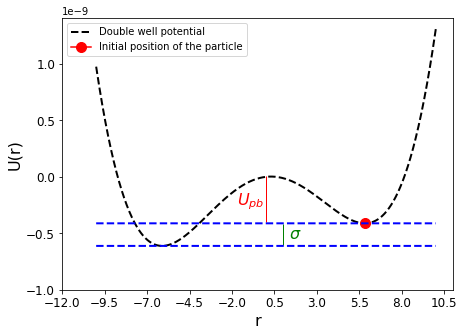

In [16]:
fig_well_prtcl = plt.figure(figsize=(7,5))
plt.plot(rdis,UEnergy, linestyle='--', color='k',linewidth=2)
plt.plot(rint,IntPE, marker=".",markersize=20, color='r')
plt.legend(["Double well potential", "Initial position of the particle"])
plt.plot(rdis,IntPE*np.ones(rdis.size), linestyle='--', color='b',linewidth=2)
plt.plot(rdis,min(UEnergy)*np.ones(rdis.size), linestyle='--', color='b',linewidth=2)
plt.text(rint-4.5,0.54*(min(UEnergy)+IntPE),'$\sigma$', fontsize=16, color='g')
plt.arrow(1.0, -0.6e-9, 0, 1e-12, width=0.4e-10, color='g')
plt.text(0.0-1.7,-0.25e-9,'$U_{pb}$', fontsize=16, color='r')
plt.arrow(0.0,-0.4e-9, 0, 1e-12, width=0.9e-10, color='r')
# plt.arrow(x=4, y=18, dx=2, dy=5, width=.06) 
# plt.title('Initial position of a particle', fontsize=12)
plt.yticks(np.arange(-1e-9, 1.5e-9, .5e-9), fontsize=12)
plt.xticks(np.arange(-12, 12, 2.5), fontsize=12) 
plt.xlabel('r', fontsize=16)  
plt.ylabel('U(r)', fontsize=16)  
plt.show()

𝛔 : Shift between bottoms of the wells (asymmetric parameter).

𝑈𝑝𝑏 : Potential barrier. 

### Step 2. Intial conditions: Initial position & velocity of particle in well

The initial position of particle is $x(t=0)$= minimum of the right well. It is clear from above figure $U_{pb}=E_{bump}-E_{minR}$. Thus, to cross the potential barrier $U_{pb}$ this particle should have the ratio of kinetic energy with $U_{pb}$ greater than unity i.e
 
 $1<V_0=\frac{{\frac{1}{2}}{m}{v^2}}{U_{pb}}$; m is the mass of the particle.

$v(t=0)=V_{coeff}{\sqrt{\frac{2U_{pb}}{m}}}$.

In the present case, we consider $V_{coeff}=1.5$ which implies that the particle will jump in the left well as well.

In [17]:
# Set initial velocity 
Vcoeff=0.9
mass=1.455000e-22
ecrg=4.803000e-10
alpha=25e-24
den=1.0000e+13
Eshift=Ubump-UminR
vint=Vcoeff*math.sqrt(2*Eshift/mass) 
zeta=2*math.pi*ecrg*math.sqrt(alpha/mass)*den;

### Step 3. Hamiltonian of the classical particle in a potential U(r) is the following

 $H=\frac{p^2}{2m}+U(r)$, where  $f(r)=-{\nabla_r}U(r)$


### Langevin equation of motion, $m{\ddot{r}}=f(r)-{\zeta}{m}{v}+{\alpha}{R}(t)$


The term ${\zeta}{m}{v}$ is the dissipative frictional force, which causes to slowdown where $\zeta={2{\pi}{e}}{\sqrt{\frac{{\alpha_p}{(m_i+m_n)}}{{m_i}{m_n}}}}{n_n}$, $n_n$ is the neutral background density and $\alpha_p$ is the polarizability of given Sr atom. 

The term ${\alpha}{R}(t)$ is the fluctuating force, which has zero mean  ${\langle{{R}}(t)\rangle}=0$  and ${\langle{{{{R}}}(t)}{\cdot}{{{{R}}}(t^{\prime})}\rangle}={\delta(t-t^{\prime})}$. Both of these terms on the RHS  satisfy the fluctuation-dissipation theorem, ${\alpha}=\sqrt{{2{K_{B}}{T}{\zeta}{m}}}$ which ensures that the system converges toward the background neutral temperature T.

### So, we can write the above Langevin equation of motion, $m{\ddot{r}}={f(r)}-{\zeta}{m}{{v}}+{\sqrt{2{K_B}T{\zeta}m}}{{{R}}(t)}$
 
 ${\dot{r}}=v$ ==> $r=r_0+v{dt}$
 
 ${\dot{v}}={\frac{f(r)}{m}}-{\zeta}{{v}}+{\sqrt{\frac{{2}{K_{B}}{T}{\zeta}}{m}}}{{R(t)}}$ ==> $v=v_0+{\frac{f(r)}{m}}{dt}-{\zeta}{v}{dt}+{\sqrt{\frac{{\delta{t}}{K_{B}}{T}{\zeta}}{m}}}{{R(t)}}$
  
  dt is the time step to advance the particle. 

In [18]:
# Define force to update it with time

def my_double_well_force(x,cntr,a,b,coff2):
    force =-4*a*(x-cntr)**3+2*b*(x-cntr)-coff2 
    return force
#print(force)

In [19]:
#         ylm = ax3.get_ylim()
#         ax3.set_ylim(ylm)

In [20]:
# Compute the PDF on the bin centers from scipy distribution object
from celluloid import Camera
%matplotlib inline
# %matplotlib notebook
from IPython.display import HTML

nsteps=2000
pltstep=10
dt = 8.0e-8 
Bz=1.380650e-23
Tcoeff=0.9
Tmp=Tcoeff*((2.0*Eshift)/Bz)
constt=math.sqrt((Bz*Tmp)/mass)
print(constt)

# np.seterr(divide='ignore', invalid='ignore')

pos=[None]*nsteps
vel=[None]*nsteps
tstep=[None]*nsteps
PEng=[None]*nsteps
KEng=[None]*nsteps
TEng=[None]*nsteps

pos = np.array(pos, dtype="object")
vel = np.array(vel, dtype="object")
tstep=np.array(tstep, dtype="object")
PEng=np.array(PEng, dtype="object")
KEng=np.array(KEng, dtype="object")
TEng=np.array(TEng, dtype="object")

fig = plt.figure(dpi = 100)
fig.set_figheight(8)
fig.set_figwidth(8)

ax1 = fig.add_subplot(221)
ax2 = fig.add_subplot(222)
ax3 = fig.add_subplot(223)
ax4 = fig.add_subplot(224)

fig.suptitle('Langevin dynamics', fontsize=20)
plt.ion()
plt.close()
camera = Camera(fig)
cntf=0

pdf = 0
##########################################################
#################### Newtonian dynamics ##################
#################### The velocity Verlet algorithm #######
##########################################################
for step in range(0,nsteps):
    cntf=cntf+1
    cnt=cntf-1
    old_pos=rint
    old_force=my_double_well_force(rint,cntr,a4,a2,coffw)
    
    # v(t) 
    #     val=np.random.randn(np.size(step*dt/2))
    #     print(val)
    vdtby2= vint + (dt/2)*(old_force/mass)-(dt/2)*zeta*vint+constt*math.sqrt(zeta)*math.sqrt(dt)*np.random.randn(np.size(step*dt/2))
    # x(t+dt) Update postion
    rdt = rint+vdtby2*dt
    
    new_force=my_double_well_force(rdt,cntr,a4,a2,coffw)
    
    # v(t+dt) Update velocity
    vdt = vdtby2 + (dt/2)*(new_force/mass)-(dt/2)*zeta*vint+constt*math.sqrt(zeta)*math.sqrt(dt)*np.random.randn(np.size(step*dt))
    
    vint=vdt
    rint=rdt
 ##########################################################
##########################################################

    npos=rdt
    nvel=vdt
    samples = npos
    
    bins = np.linspace(rmin, rmax, 50)
    histogram, bins = np.histogram(samples, bins=bins, density=True)
    bin_centers = 0.5*(bins[1:] + bins[:-1])
    pdf = pdf + histogram
    pdfun= pdf/np.sum(pdf)
    num=max(pdfun)
#     print(num)

    UPE =a4*(npos-cntr)**4-a2*(npos-cntr)**2+coffw*(npos-cntr)
    KE=0.5*mass*(nvel**2)
    TE=UPE+KE  
    
    pos[step]=npos
    vel[step]=nvel   
    tstep[step]=step
    PEng[step]=UPE
    KEng[step]=KE
    TEng[step]=TE  
    time=cnt*dt
#     step=step-1
#   
    if step % pltstep == 0:
#         ax3.cla()
        print(step)
        ax1.plot(rdis,UEnergy, linestyle='--', color='k',linewidth=2)
        ax1.plot(rint,UPE, marker=".",color='r', markersize=10) 
        ax1.set_xlim([-12, 12])
        ax1.set_ylim([-1e-9, 1.5e-9])
        ax1.set_title('Particle in well')
        ax1.legend(['Step=%i' %cnt])
        ax1.set_xlabel('r', fontsize=12)  
        ax1.set_ylabel('U(r)', fontsize=12) 
        
        ax2.plot(pos,vel, linestyle='-', color='k',linewidth=2)
        ax2.plot(rint,vint, marker=".",color='r', markersize=10)
        ax2.set_xlim([-12, 12])
        ax2.set_title('Phase Space')
        ax2.legend(['t=%.2e' %time])
        ax2.set_xlabel('r', fontsize=16)  
        ax2.set_ylabel('Vel(r)', fontsize=16) 
        
        ax3.plot(bin_centers,pdfun, marker=".",color='r', markersize=5) 
        ax3.set_title('Probality density distribution')
        ax3.legend(['Step=%i' %cnt])
        ax3.set_xlabel('r', fontsize=16)  
        ax3.set_ylabel('Pdf (r)', fontsize=16)
        ax3.set_ylim([0, 0.3])
#         ax3.autoscale(enable=True, axis='y', tight=False)
        
        ax4.plot(tstep,PEng,'g',tstep,KEng,'b',tstep,TEng,'r')
        ax4.legend(['Pot Eng=%i' %cnt, 'Kin Eng', 'Total Eng'])
        ax4.set_xlim([0,nsteps])
        ax4.set_title('Energy Conservation')
        ax4.set_xlabel('Step', fontsize=16)  
        ax4.set_ylabel('Energy', fontsize=16)  
        ax4.set_xticks(np.arange(0, nsteps, (nsteps-1)/2), minor=False)
        plt.draw()
        fig.canvas.draw() 
        camera.snap() 
#         plt.pause(.2) 
        fig.tight_layout(pad=2.0)
# animation = camera.animate(blit=True, interval=10)        
animation = camera.animate()
# HTML(animation.to_html5_video())
animation.save('d_animation_dw_Langevin.mp4')
HTML(animation.to_jshtml())
# animation.save('animation1.gif', writer='pillow', fps=2)

2262864.829217174
0
10
20
30
40
50
60
70
80
90
100
110
120
130
140
150
160
170
180
190
200
210
220
230
240
250
260
270
280
290
300
310
320
330
340
350
360
370
380
390
400
410
420
430
440
450
460
470
480
490
500
510
520
530
540
550
560
570
580
590
600
610
620
630
640
650
660
670
680
690
700
710
720
730
740
750
760
770
780
790
800
810
820
830
840
850
860
870
880
890
900
910
920
930
940
950
960
970
980
990
1000
1010
1020
1030
1040
1050
1060
1070
1080
1090


<ipython-input-20-b71d2a366dec>:139: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.tight_layout(pad=2.0)


1100
1110


<ipython-input-20-b71d2a366dec>:136: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.draw()


1120
1130
1140
1150
1160
1170
1180
1190
1200


<ipython-input-20-b71d2a366dec>:136: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.draw()


1210


<ipython-input-20-b71d2a366dec>:136: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.draw()
<ipython-input-20-b71d2a366dec>:139: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.tight_layout(pad=2.0)


1220


<ipython-input-20-b71d2a366dec>:136: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.draw()


1230
1240
1250
1260
1270
1280
1290
1300
1310
1320
1330
1340


<ipython-input-20-b71d2a366dec>:136: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.draw()


1350


<ipython-input-20-b71d2a366dec>:136: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.draw()


1360


<ipython-input-20-b71d2a366dec>:136: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.draw()
<ipython-input-20-b71d2a366dec>:139: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.tight_layout(pad=2.0)


1370


<ipython-input-20-b71d2a366dec>:136: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.draw()


1380


<ipython-input-20-b71d2a366dec>:136: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.draw()


1390
1400
1410
1420
1430
1440
1450


<ipython-input-20-b71d2a366dec>:136: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.draw()


1460
1470
1480
1490
1500
1510
1520
1530
1540
1550
1560
1570
1580
1590
1600
1610
1620
1630
1640
1650
1660
1670
1680


<ipython-input-20-b71d2a366dec>:136: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.draw()


1690
1700


<ipython-input-20-b71d2a366dec>:136: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.draw()


1710
1720
1730
1740
1750
1760
1770


<ipython-input-20-b71d2a366dec>:136: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.draw()


1780


<ipython-input-20-b71d2a366dec>:136: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.draw()


1790
1800


<ipython-input-20-b71d2a366dec>:136: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.draw()


1810


<ipython-input-20-b71d2a366dec>:136: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.draw()
<ipython-input-20-b71d2a366dec>:139: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.tight_layout(pad=2.0)


1820
1830
1840
1850
1860
1870


<ipython-input-20-b71d2a366dec>:136: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.draw()


1880
1890
1900


<ipython-input-20-b71d2a366dec>:136: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.draw()
<ipython-input-20-b71d2a366dec>:139: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.tight_layout(pad=2.0)


1910


<ipython-input-20-b71d2a366dec>:136: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.draw()


1920
1930


<ipython-input-20-b71d2a366dec>:139: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.tight_layout(pad=2.0)


1940


<ipython-input-20-b71d2a366dec>:136: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.draw()


1950
1960
1970
1980
1990


<ipython-input-20-b71d2a366dec>:143: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  animation.save('z_animation_Langevin_0p0_damping.mp4')
Animation size has reached 21047203 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


<Figure size 432x288 with 0 Axes>